In [1]:
using StaticArrays, LinearAlgebra, Plots

abstract type AbstractTiles{N,T} end
function grow_tile(tile::AbstractTiles)
    new_str = sprint() do io
        for c in tile.str
            print(io, get(tile.rules, c, string(c)))
        end
    end
    new_level = tile.level + 1
    return (typeof(tile))(new_level, new_str, tile.positions, tile.angle, tile.rules)
end
function string2positions(tile::AbstractTiles{2,T}) where T
    pos = tile.positions[1]
    direction = SVector(0.0, 1.0)
    positions = SVector{2,T}[]
    push!(positions, pos)
    for cmd in collect(tile.str)
        if cmd == 'F'
            pos += direction
            push!(positions, pos)
        elseif cmd == '+'
            θ = tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        elseif cmd == '-'
            θ = -tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        end
    end
    return (typeof(tile))(tile.level, tile.str, positions, tile.angle, tile.rules)
end


string2positions (generic function with 1 method)

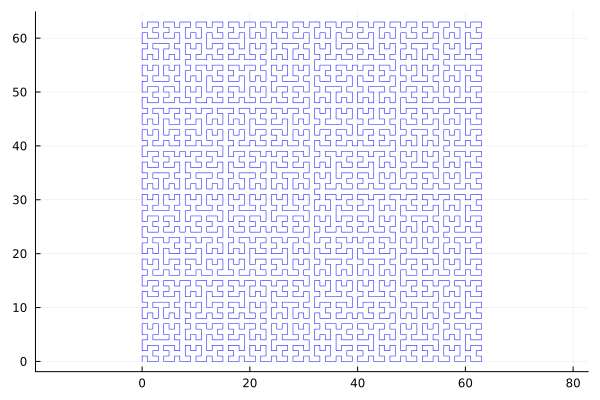

print device already activated


In [20]:
@kwdef struct Square{N,T} <: AbstractTiles{N,T}
    level::Int = 0
    str::String = "A"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::Union{T,Nothing} = π / 2
    rules::Dict{Char,String} = Dict(
        'A' => "-BF+AFA+FB-",
        'B' => "+AF-BFB-FA+"
    )
end

tile = Square{2,Float64}()

for g in 1:6
    tile = grow_tile(tile)
end
tile = string2positions(tile)

mat = reduce(hcat, tile.positions)
p = plot(aspect_ratio=1, legend=false)
plot!(p, mat[1, :], mat[2, :], lw=0.5, color=:blue)


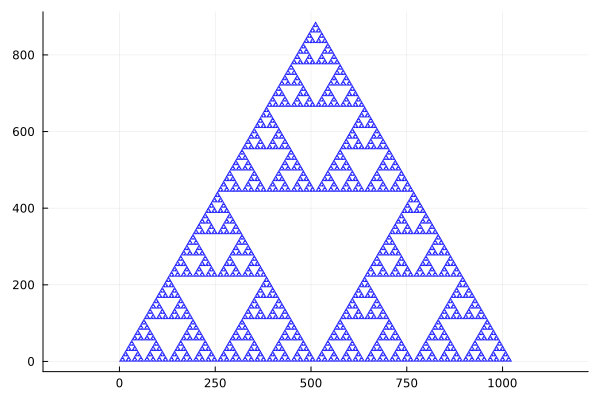

In [21]:
@kwdef struct SierpinskiGasket{N,T} <: AbstractTiles{N,T}
    level::Int = 0
    str::String = "A"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::Union{T,Nothing} = π / 3
    rules::Dict{Char,String} = Dict(
        'A' => "B-A-B",
        'B' => "A+B+A"
    )
end
function string2positions(tile::SierpinskiGasket{2,T}) where T
    curr_pos = tile.positions[1]
    direction = SVector{2,T}(1.0, 0.0)
    new_positions = SVector{2,T}[]
    push!(new_positions, curr_pos)

    for cmd in tile.str
        if cmd == 'A' || cmd == 'B'
            curr_pos += direction
            push!(new_positions, curr_pos)
        elseif cmd == '+'
            θ = tile.angle # π/3 (60度)
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        elseif cmd == '-'
            θ = -tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        end
    end
    return (typeof(tile))(tile.level, tile.str, new_positions, tile.angle, tile.rules)
end
tile = SierpinskiGasket{2,Float64}()

for g in 1:10
    tile = grow_tile(tile)
end
tile = string2positions(tile)

mat = reduce(hcat, tile.positions)
p = plot(aspect_ratio=1, legend=false)
plot!(p, mat[1, :], mat[2, :], lw=0.5, color=:blue)


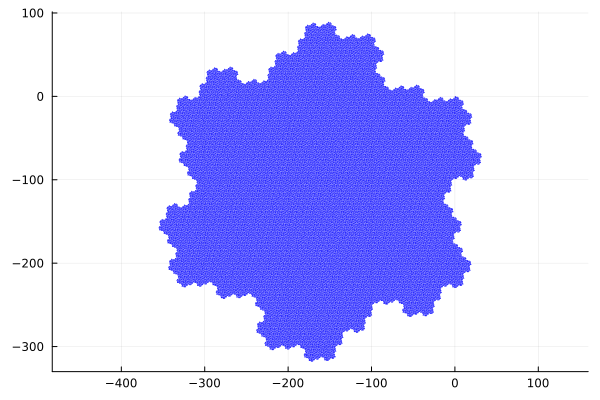

In [22]:
@kwdef struct GosperCurve{N,T} <: AbstractTiles{N,T}
    level::Int = 0
    str::String = "A"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::Union{T,Nothing} = π / 3
    rules::Dict{Char,String} = Dict(
        'A' => "A-B--B+A++AA+B-",
        'B' => "+A-BB--B-A++A+B"
    )
end
function string2positions(tile::GosperCurve{2,T}) where T
    curr_pos = tile.positions[1]
    direction = SVector{2,T}(1.0, 0.0)
    new_positions = SVector{2,T}[]
    push!(new_positions, curr_pos)

    for cmd in tile.str
        if cmd == 'A' || cmd == 'B'
            curr_pos += direction
            push!(new_positions, curr_pos)
        elseif cmd == '+'
            θ = tile.angle # π/3 (60度)
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        elseif cmd == '-'
            θ = -tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        end
    end
    return (typeof(tile))(tile.level, tile.str, new_positions, tile.angle, tile.rules)
end
tile = GosperCurve{2,Float64}()

for g in 1:6
    tile = grow_tile(tile)
end
tile = string2positions(tile)

mat = reduce(hcat, tile.positions)
p = plot(aspect_ratio=1, legend=false)
plot!(p, mat[1, :], mat[2, :], lw=0.5, color=:blue)


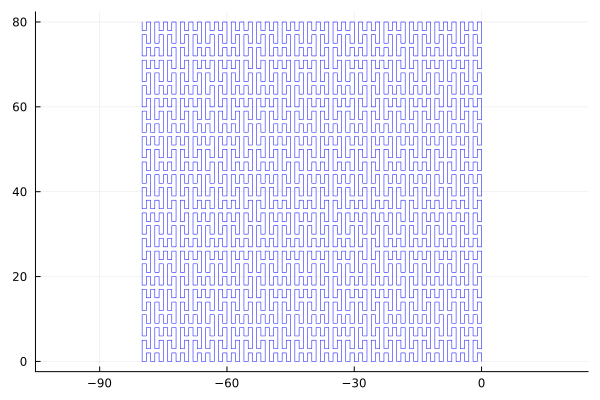

In [22]:
@kwdef struct PeanoCurve{N,T} <: AbstractTiles{N,T}
    level::Int = 0
    str::String = "X"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::Union{T,Nothing} = π / 2
    rules::Dict{Char,String} = Dict(
        'X' => "XFYFX+F+YFXFY-F-XFYFX",
        'Y' => "YFXFY-F-XFYFX+F+YFXFY"
    )
end
function string2positions(tile::PeanoCurve{2,T}) where T
    pos = tile.positions[1]
    direction = SVector(0.0, 1.0)
    positions = SVector{2,T}[]
    push!(positions, pos)
    for cmd in collect(tile.str)
        if cmd == 'F'
            pos += direction
            push!(positions, pos)
        elseif cmd == '+'
            θ = tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        elseif cmd == '-'
            θ = -tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        end
    end
    return (typeof(tile))(tile.level, tile.str, positions, tile.angle, tile.rules)
end
tile = PeanoCurve{2,Float64}()

for g in 1:4
    tile = grow_tile(tile)
end
tile = string2positions(tile)

mat = reduce(hcat, tile.positions)
p = plot(aspect_ratio=1, legend=false)
plot!(p, mat[1, :], mat[2, :], lw=0.5, color=:blue)


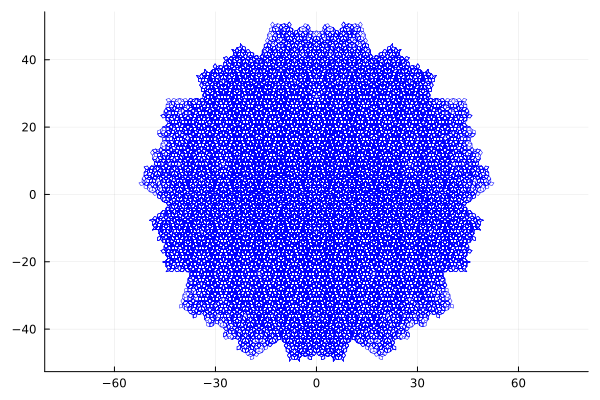

In [45]:
using StaticArrays, LinearAlgebra, Plots

@kwdef struct PenroseLSystem{N,T} <: AbstractTiles{N,T}
    level::Int = 0
    str::String = "[X]++[X]++[X]++[X]++[X]"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::T = deg2rad(36.0) # 36度
    rules::Dict{Char,String} = Dict(
        'W' => "YF++ZF4-XF[-YF4-WF]++",
        'X' => "+YF--ZF[3-WF--XF]+",
        'Y' => "-WF++XF[+++YF++ZF]-",
        'Z' => "--YF++++WF[+ZF++++XF]--XF"
    )
end
function grow_tile(tile::AbstractTiles{N,T}) where {N,T}
    new_str = sprint() do io
        for c in tile.str
            if haskey(tile.rules, c)
                print(io, tile.rules[c])
            elseif c != 'F'
                print(io, c)
            end
        end
    end
    return (typeof(tile))(tile.level + 1, new_str, tile.positions, tile.angle, tile.rules)
end
function string2positions(tile::AbstractTiles{2,T}) where T
    curr_pos = tile.positions[1]
    curr_dir = SVector{2,T}(0.0, 1.0) # 初期方向（上向き）
    # 状態保存用のスタック (position, direction)
    stack = Tuple{SVector{2,T},SVector{2,T}}[]
    # 描画用の座標リスト
    positions = SVector{2,T}[]
    push!(positions, curr_pos)
    repeats = 1
    for cmd in tile.str
        if isdigit(cmd)
            repeats = parse(Int, cmd)
            continue
        end
        for _ in 1:repeats
            if cmd == 'F'
                curr_pos += curr_dir
                push!(positions, curr_pos)
            elseif cmd == '+'
                θ = tile.angle
                rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
                curr_dir = rot * curr_dir
            elseif cmd == '-'
                θ = -tile.angle
                rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
                curr_dir = rot * curr_dir
            elseif cmd == '['
                # 現在の場所と向きを保存
                push!(stack, (curr_pos, curr_dir))
            elseif cmd == ']'
                # 保存した場所に戻る
                if !isempty(stack)
                    curr_pos, curr_dir = pop!(stack)
                    push!(positions, SVector{2,T}(NaN, NaN))
                    push!(positions, curr_pos)
                end
            end
        end
        repeats = 1
    end
    return (typeof(tile))(tile.level, tile.str, positions, tile.angle, tile.rules)
end
tile = PenroseLSystem{2,Float64}()
for g in 1:8
    tile = grow_tile(tile)
end
tile = string2positions(tile)
mat = reduce(hcat, tile.positions)
p = plot(aspect_ratio=1, legend=false)
plot!(p, mat[1, :], mat[2, :], lw=0.5, color=:blue)


Total sites: 9649
Non-zero bonds: 19224


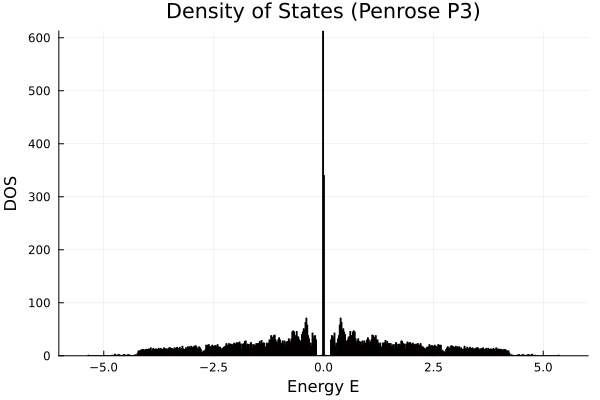

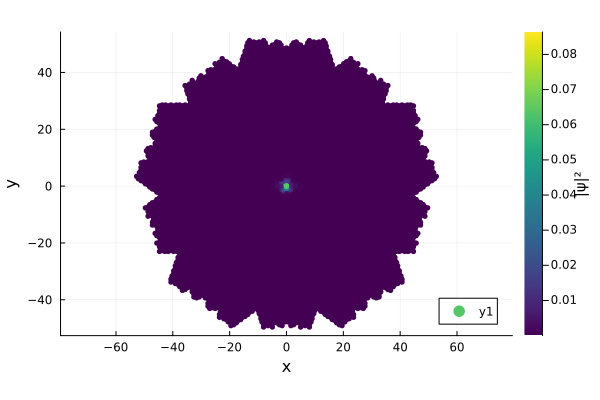

In [46]:
using SparseArrays

"""
L-Systemの描画パスからタイトバインディング模型のサイトとボンドを抽出する
"""
function build_tight_binding(tile::AbstractTiles{2,T}; tol=1e-5) where T
    raw_pos = filter(p -> !any(isnan, p), tile.positions)
    round_pos(p) = SVector{2,T}(round.(p, digits=Int(-log10(tol))))

    unique_sites = SVector{2,T}[]
    pos_to_idx = Dict{SVector{2,T},Int}()

    for p in raw_pos
        rp = round_pos(p)
        if !haskey(pos_to_idx, rp)
            push!(unique_sites, p) # オリジナルの座標を保持
            pos_to_idx[rp] = length(unique_sites)
        end
    end

    n_sites = length(unique_sites)
    adj_matrix = spzeros(T, n_sites, n_sites)

    for i in 1:(length(tile.positions)-1)
        p1 = tile.positions[i]
        p2 = tile.positions[i+1]
        if !any(isnan, p1) && !any(isnan, p2)
            idx1 = pos_to_idx[round_pos(p1)]
            idx2 = pos_to_idx[round_pos(p2)]
            if idx1 != idx2
                adj_matrix[idx1, idx2] = 1.0
                adj_matrix[idx2, idx1] = 1.0 # 無向グラフ
            end
        end
    end
    return unique_sites, adj_matrix
end
sites, H = build_tight_binding(tile)
println("Total sites: ", length(sites))
println("Non-zero bonds: ", nnz(H) ÷ 2)
using LinearAlgebra, Arpack # Arpackは基底状態のみ抽出する場合に使用

# --- 1. 固有値の計算 ---
energies = eigvals(Matrix(H)) # 全固有値を計算

p_dos = histogram(energies, bins=500,
    xlabel="Energy E", ylabel="DOS",
    title="Density of States (Penrose P3)",
    fillalpha=0.6, color=:darkred, legend=false)
display(p_dos)
# --- 1. 基底状態（エネルギー最小の固有ベクトル）の抽出 ---
vals, vecs = eigs(H, which=:SR, nev=1)
ground_state_vector = abs2.(vecs[:, 1])

p_density = scatter(
    [p[1] for p in sites], [p[2] for p in sites],
    marker_z=ground_state_vector,
    ms=3,
    markerstrokewidth=0,
    color=:viridis,
    aspect_ratio=1,
    xlabel="x", ylabel="y",
    colorbar_title="|ψ|²",
    cscale=:log10,
)


In [ ]:
using StaticArrays, LinearAlgebra, Plots

@kwdef struct PenroseLSystem{N,T} <: AbstractTiles{N,T}
    level::Int = 0
    str::String = "F-F-F-F"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::T = deg2rad(36.0) # 36度
    rules::Dict{Char,String} = Dict(
        'W' => "YF++ZF4-XF[-YF4-WF]++",
        'X' => "+YF--ZF[3-WF--XF]+",
        'Y' => "-WF++XF[+++YF++ZF]-",
        'Z' => "--YF++++WF[+ZF++++XF]--XF"
    )
end
function grow_tile(tile::AbstractTiles{N,T}) where {N,T}
    new_str = sprint() do io
        for c in tile.str
            if haskey(tile.rules, c)
                print(io, tile.rules[c])
            elseif c != 'F'
                print(io, c)
            end
        end
    end
    return (typeof(tile))(tile.level + 1, new_str, tile.positions, tile.angle, tile.rules)
end
function string2positions(tile::AbstractTiles{2,T}) where T
    curr_pos = tile.positions[1]
    curr_dir = SVector{2,T}(0.0, 1.0) # 初期方向（上向き）
    # 状態保存用のスタック (position, direction)
    stack = Tuple{SVector{2,T},SVector{2,T}}[]
    # 描画用の座標リスト
    positions = SVector{2,T}[]
    push!(positions, curr_pos)
    repeats = 1
    for cmd in tile.str
        if isdigit(cmd)
            repeats = parse(Int, cmd)
            continue
        end
        for _ in 1:repeats
            if cmd == 'F'
                curr_pos += curr_dir
                push!(positions, curr_pos)
            elseif cmd == '+'
                θ = tile.angle
                rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
                curr_dir = rot * curr_dir
            elseif cmd == '-'
                θ = -tile.angle
                rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
                curr_dir = rot * curr_dir
            elseif cmd == '['
                # 現在の場所と向きを保存
                push!(stack, (curr_pos, curr_dir))
            elseif cmd == ']'
                # 保存した場所に戻る
                if !isempty(stack)
                    curr_pos, curr_dir = pop!(stack)
                    push!(positions, SVector{2,T}(NaN, NaN))
                    push!(positions, curr_pos)
                end
            end
        end
        repeats = 1
    end
    return (typeof(tile))(tile.level, tile.str, positions, tile.angle, tile.rules)
end
tile = PenroseLSystem{2,Float64}()
for g in 1:8
    tile = grow_tile(tile)
end
tile = string2positions(tile)
mat = reduce(hcat, tile.positions)
p = plot(aspect_ratio=1, legend=false)
plot!(p, mat[1, :], mat[2, :], lw=0.5, color=:blue)


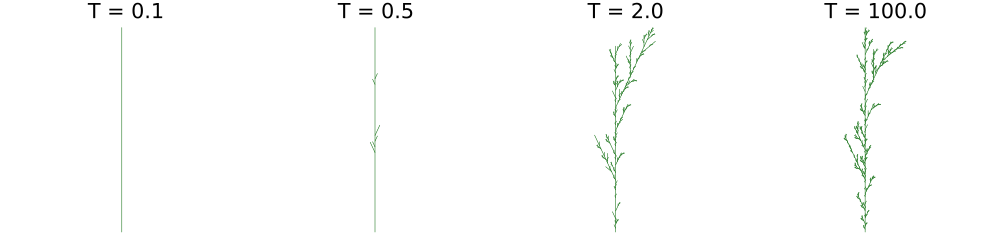

In [57]:
using StaticArrays, LinearAlgebra, Plots, StatsBase

# --- 定義 ---

# ルールにエネルギーを持たせる構造体
struct WeightedRule
    successor::String
    energy::Float64
end

@kwdef struct StochasticLSystem{N,T}
    level::Int = 0
    str::String = "F"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::T = deg2rad(25.0)
    # 文字 -> [候補ルールリスト]
    rules::Dict{Char,Vector{WeightedRule}} = Dict(
        'F' => [
            WeightedRule("FF", 0.0),            # 基底状態：ただ伸びる（結晶成長的）
            WeightedRule("F[+F]F[-F]F", 1.0)    # 励起状態：分岐する（欠陥・乱れ）
        ]
    )
end

# ボルツマン分布に従ってルールを選ぶ関数
function pick_rule(rules::Vector{WeightedRule}, β::Float64)
    energies = [r.energy for r in rules]
    # Z = Σ e^(-βE)
    weights = exp.(-β .* energies)
    # 確率分布を作成してサンプリング
    return sample(rules, Weights(weights)).successor
end

# 確率的成長関数
function grow_stochastic(sys::StochasticLSystem{N,T}, temperature::Float64) where {N,T}
    β = 1.0 / temperature # 逆温度
    new_str = sprint() do io
        for c in sys.str
            if haskey(sys.rules, c)
                # ここで確率的に選択！
                chosen_str = pick_rule(sys.rules[c], β)
                print(io, chosen_str)
            else
                print(io, c)
            end
        end
    end
    # positionは描画時に計算するのでここでは更新しない（metadataだけ引き継ぐ）
    return StochasticLSystem{N,T}(level=sys.level + 1, str=new_str, angle=sys.angle, rules=sys.rules)
end

# 座標計算（ご提示のコードとほぼ同じですが、2D専用にしています）
function string2positions(sys::StochasticLSystem{2,T}) where T
    curr_pos = SVector{2,T}(0.0, 0.0)
    curr_dir = SVector{2,T}(0.0, 1.0)
    stack = Tuple{SVector{2,T},SVector{2,T}}[]
    positions = [curr_pos] # NaN区切りで描画するため、Vector{SVector}のVectorにはしない

    # Plotのsegment描画用に (x1, y1), (x2, y2) のペアを集めるのが効率的ですが
    # ここでは簡易的に NaN で線を切る方式にします

    x_vals = Float64[0.0]
    y_vals = Float64[0.0]

    for cmd in sys.str
        if cmd == 'F'
            new_pos = curr_pos + curr_dir
            push!(x_vals, new_pos[1])
            push!(y_vals, new_pos[2])
            curr_pos = new_pos
        elseif cmd == '+'
            θ = sys.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            curr_dir = rot * curr_dir
        elseif cmd == '-'
            θ = -sys.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            curr_dir = rot * curr_dir
        elseif cmd == '['
            push!(stack, (curr_pos, curr_dir))
        elseif cmd == ']'
            if !isempty(stack)
                curr_pos, curr_dir = pop!(stack)
                # 描画の線を切る
                push!(x_vals, NaN)
                push!(y_vals, NaN)
                push!(x_vals, curr_pos[1])
                push!(y_vals, curr_pos[2])
            end
        end
    end
    return x_vals, y_vals
end

# --- メイン実行 ---

# シミュレーション設定
levels = 5
temps = [0.1, 0.5, 2.0, 100.0] # 低温 -> 高温
plts = []

for T in temps
    sys = StochasticLSystem{2,Float64}()
    # 成長
    for _ in 1:levels
        sys = grow_stochastic(sys, T)
    end

    # 描画データ作成
    xs, ys = string2positions(sys)

    # プロット
    p = plot(xs, ys, aspect_ratio=1, legend=false,
        title="T = $T", lw=0.5, color=:darkgreen, axis=nothing, border=:none)
    push!(plts, p)
end

plot(plts..., layout=(1, 4), size=(1000, 250))


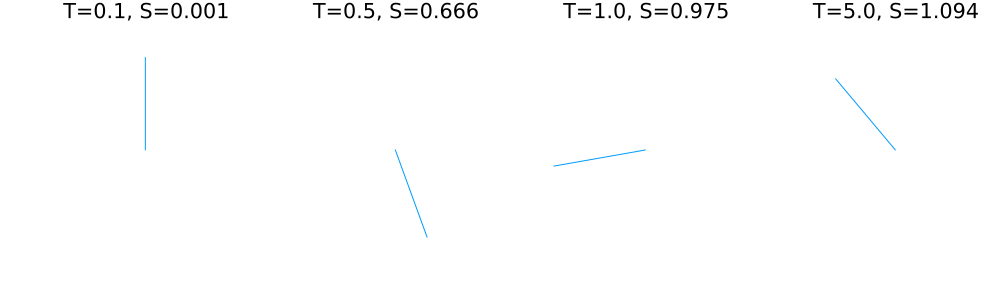

In [76]:
using StaticArrays, LinearAlgebra, Plots, StatsBase

# --- 1D Directed Path L-System ---

function simulate_directed_walk(steps, temp, ε=1.0)
    β = 1.0 / temp

    # ルールとエネルギーの定義
    # "F" は現在の先端。次のステップでどう動くか。
    options = ["F", "+F", "-F"]
    energies = [0.0, ε, ε]

    # ボルツマン重みの計算
    weights = exp.(-β .* energies)
    prob_dist = Weights(weights)

    # 成長プロセスのシミュレーション
    # L-systemの文字列を生成していく
    current_str = "F"
    for _ in 1:steps
        # 文字列の最後の'F'（先端）を置換する
        # 本来のL-systemは全置換ですが、今回は「軌跡」を描くため先端を伸ばします
        choice = sample(options, prob_dist)
        # 最後のFを置換（簡易的な実装）
        current_str = current_str[1:end-1] * choice
    end

    return current_str
end

# 描画用の座標計算
function walk_to_coords(str, angle_deg=30.0)
    θ = deg2rad(angle_deg)
    rot_left = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
    rot_right = @SMatrix [cos(-θ) -sin(-θ); sin(-θ) cos(-θ)]

    curr_pos = SVector(0.0, 0.0)
    curr_dir = SVector(0.0, 1.0) # 最初は上向き

    xs, ys = [0.0], [0.0]

    for cmd in str
        if cmd == 'F'
            curr_pos += curr_dir
            push!(xs, curr_pos[1])
            push!(ys, curr_pos[2])
        elseif cmd == '+'
            curr_dir = rot_left * curr_dir
        elseif cmd == '-'
            curr_dir = rot_right * curr_dir
        end
    end
    return xs, ys
end

# --- エントロピーの計算 ---
function calculate_entropy(temp, ε=1.0)
    β = 1.0 / temp
    energies = [0.0, ε, ε]
    weights = exp.(-β .* energies)
    Z = sum(weights)
    p = weights ./ Z
    # Shannon entropy: -Σ p log p
    return -sum(p .* log.(p .+ 1e-15))
end

# --- 実行と可視化 ---

steps = 100
temps = [0.1, 0.5, 1.0, 5.0]
plt_walks = []

for T in temps
    str = simulate_directed_walk(steps, T)
    xs, ys = walk_to_coords(str, 20.0) # 20度ずつ曲がる
    S = round(calculate_entropy(T), digits=3)

    p = plot(xs, ys, title="T=$T, S=$S", aspect_ratio=1,
        lw=1, label="", xlim=(-1, 1), ylim=(-1, 1), border=:none)
    push!(plt_walks, p)
end

plot(plt_walks..., layout=(1, length(temps)), size=(1000, 300))


In [ ]:
using StatsBase, Plots
# --- 1D Ising L-System ---
function ising_growth(steps, T, J=1.0)
    β = 1.0 / T
    states = ["++", "+-", "-+", "--"]
    current_str = "+" # 初期状態（マクロな1スピン）
    for _ in 1:steps
        next_str = ""
        for s in current_str
            parent_val = (s == '+' ? 1 : -1)
            energies = map(states) do st
                s1 = (st[1] == '+' ? 1 : -1)
                s2 = (st[2] == '+' ? 1 : -1)
                return -J * (s1 * s2) - 0.5J * parent_val * (s1 + s2)
            end
            weights = exp.(-β .* energies)
            chosen_st = states[sample(1:4, Weights(weights))]
            if s == '-'
                chosen_st = replace(replace(chosen_st, "+" => "temp"), "-" => "+", "temp" => "-")
            end
            next_str *= chosen_st
        end
        current_str = next_str
    end
    return current_str
end
T_list = [i for i in 0.1:0.1:2.0]
mag = Float64[]